In [11]:
# First let's import the packages we will use in this project
# You can do this all now or as you need them
import pandas as pd
import numpy as np
import seaborn as sns

import matplotlib.pyplot as plt
import matplotlib.mlab as mlab
import matplotlib
plt.style.use('ggplot')
from matplotlib.pyplot import figure

%matplotlib inline
matplotlib.rcParams['figure.figsize'] = (12,8)

pd.options.mode.chained_assignment = None



# Now we need to read in the data
df = pd.read_csv(r'C:\Users\Hp\Downloads\movies.csv')

In [167]:
# Now let's take a look at the data

df.head()

,name,rating,genre,released,score,votes,director,writer,star,country,budget,gross,company,runtime,year
0,6587,6,6,1697,8,927000,2589,4014,1047,54,19000000,46998772,2319,146,47
1,5573,6,1,1484,5,65000,2269,1632,327,55,4500000,58853106,731,104,47
2,5142,4,0,1763,8,1200000,1111,2567,1745,55,18000000,538375067,1540,124,47
3,286,4,4,1484,7,221000,1301,2000,2246,55,3500000,83453539,1812,88,47
4,1027,6,4,1535,7,108000,1054,521,410,55,6000000,39846344,1777,98,47


In [44]:
# CARA MELIHAT APAKAH ADA DATA YANG HILANG
# KOLOMNYA DI-LOOP
#Newdf = df.dropna(axis=0)
#print(Newdf.isnull().sum(),'\n')


for col in df.columns:
    pct_missing = np.mean(df[col].isnull())
    print('{} - {}%'.format(col,round(pct_missing)))

name - 0%
rating - 0%
genre - 0%
year - 0%
released - 0%
score - 0%
votes - 0%
director - 0%
writer - 0%
star - 0%
country - 0%
budget - 0%
gross - 0%
company - 0%
runtime - 0%
yearcorrect - 0%


In [45]:
df.dtypes

name            object
rating          object
genre           object
year             int64
released        object
score          float64
votes          float64
director        object
writer          object
star            object
country         object
budget         float64
gross          float64
company         object
runtime        float64
yearcorrect     object
dtype: object

In [138]:
# Drop data NaN 
# Change NaN to zero value 

df['votes'] = df['votes'].fillna(0)
df['budget'] = df['budget'].fillna(0)
df['gross'] = df['gross'].fillna(0)
df['runtime'] = df['runtime'].fillna(0)
df['score'] = df['score'].fillna(0)

df.head()

,name,rating,genre,released,score,votes,director,writer,star,country,budget,gross,company,runtime,year
0,The Shining,R,Drama,"June 13, 1980 (Unite",8,927000,Stanley Kubrick,Stephen King,Jack Nicholson,United Kingdom,19000000,46998772,Warner Bros.,146,1980
1,The Blue Lagoon,R,Adventure,"July 2, 1980 (Unite",5,65000,Randal Kleiser,Henry De Vere Stacpoole,Brooke Shields,United States,4500000,58853106,Columbia Pictures,104,1980
2,Star Wars: Episode V - The Empire Strikes Back,PG,Action,"June 20, 1980 (Unite",8,1200000,Irvin Kershner,Leigh Brackett,Mark Hamill,United States,18000000,538375067,Lucasfilm,124,1980
3,Airplane!,PG,Comedy,"July 2, 1980 (Unite",7,221000,Jim Abrahams,Jim Abrahams,Robert Hays,United States,3500000,83453539,Paramount Pictures,88,1980
4,Caddyshack,R,Comedy,"July 25, 1980 (Unite",7,108000,Harold Ramis,Brian Doyle-Murray,Chevy Chase,United States,6000000,39846344,Orion Pictures,98,1980


In [67]:
# change data type from FLOAT to INT

df['votes'] = df['votes'].astype('int64')
df['budget'] = df['budget'].astype('int64')
df['gross'] = df['gross'].astype('int64')
df['runtime'] = df['runtime'].astype('int64')
df['score'] = df['score'].astype('int64')
df.dtypes

name           object
rating         object
genre          object
year            int64
released       object
score           int64
votes           int64
director       object
writer         object
star           object
country        object
budget          int64
gross           int64
company        object
runtime         int64
yearcorrect    object
dtype: object

In [139]:
# Throw the Released column, make a new year column 
df[['date','year']]=df['released'].str.split('(',expand=True)
#df.pop('year')
df['year']=df['date'].str[-5:]
df.pop('date')
df.head()

,name,rating,genre,released,score,votes,director,writer,star,country,budget,gross,company,runtime,year
0,The Shining,R,Drama,"June 13, 1980 (Unite",8,927000,Stanley Kubrick,Stephen King,Jack Nicholson,United Kingdom,19000000,46998772,Warner Bros.,146,1980
1,The Blue Lagoon,R,Adventure,"July 2, 1980 (Unite",5,65000,Randal Kleiser,Henry De Vere Stacpoole,Brooke Shields,United States,4500000,58853106,Columbia Pictures,104,1980
2,Star Wars: Episode V - The Empire Strikes Back,PG,Action,"June 20, 1980 (Unite",8,1200000,Irvin Kershner,Leigh Brackett,Mark Hamill,United States,18000000,538375067,Lucasfilm,124,1980
3,Airplane!,PG,Comedy,"July 2, 1980 (Unite",7,221000,Jim Abrahams,Jim Abrahams,Robert Hays,United States,3500000,83453539,Paramount Pictures,88,1980
4,Caddyshack,R,Comedy,"July 25, 1980 (Unite",7,108000,Harold Ramis,Brian Doyle-Murray,Chevy Chase,United States,6000000,39846344,Orion Pictures,98,1980


In [145]:
# Sort the data based on Gross column
df.sort_values(by=['gross'],inplace=False,ascending=False)

# Show the scroll button 
pd.set_option('display.max_rows',None)


,name,rating,genre,released,score,votes,director,writer,star,country,budget,gross,company,runtime,year
0,The Shining,R,Drama,"June 13, 1980 (Unite",8,927000,Stanley Kubrick,Stephen King,Jack Nicholson,United Kingdom,19000000,46998772,Warner Bros.,146,1980
1,The Blue Lagoon,R,Adventure,"July 2, 1980 (Unite",5,65000,Randal Kleiser,Henry De Vere Stacpoole,Brooke Shields,United States,4500000,58853106,Columbia Pictures,104,1980
2,Star Wars: Episode V - The Empire Strikes Back,PG,Action,"June 20, 1980 (Unite",8,1200000,Irvin Kershner,Leigh Brackett,Mark Hamill,United States,18000000,538375067,Lucasfilm,124,1980
3,Airplane!,PG,Comedy,"July 2, 1980 (Unite",7,221000,Jim Abrahams,Jim Abrahams,Robert Hays,United States,3500000,83453539,Paramount Pictures,88,1980
4,Caddyshack,R,Comedy,"July 25, 1980 (Unite",7,108000,Harold Ramis,Brian Doyle-Murray,Chevy Chase,United States,6000000,39846344,Orion Pictures,98,1980
5,Friday the 13th,R,Horror,"May 9, 1980 (Unite",6,123000,Sean S. Cunningham,Victor Miller,Betsy Palmer,United States,550000,39754601,Paramount Pictures,95,1980
6,The Blues Brothers,R,Action,"June 20, 1980 (Unite",7,188000,John Landis,Dan Aykroyd,John Belushi,United States,27000000,115229890,Universal Pictures,133,1980
7,Raging Bull,R,Biography,"December 19, 1980 (Unite",8,330000,Martin Scorsese,Jake LaMotta,Robert De Niro,United States,18000000,23402427,Chartoff-Winkler Productions,129,1980
8,Superman II,PG,Action,"June 19, 1981 (Unite",6,101000,Richard Lester,Jerry Siegel,Gene Hackman,United States,54000000,108185706,Dovemead Films,127,1981
9,The Long Riders,R,Biography,"May 16, 1980 (Unite",7,10000,Walter Hill,Bill Bryden,David Carradine,United States,10000000,15795189,United Artists,100,1980


In [149]:
df.drop_duplicates()


,name,rating,genre,released,score,votes,director,writer,star,country,budget,gross,company,runtime,year
0,The Shining,R,Drama,"June 13, 1980 (Unite",8,927000,Stanley Kubrick,Stephen King,Jack Nicholson,United Kingdom,19000000,46998772,Warner Bros.,146,1980
1,The Blue Lagoon,R,Adventure,"July 2, 1980 (Unite",5,65000,Randal Kleiser,Henry De Vere Stacpoole,Brooke Shields,United States,4500000,58853106,Columbia Pictures,104,1980
2,Star Wars: Episode V - The Empire Strikes Back,PG,Action,"June 20, 1980 (Unite",8,1200000,Irvin Kershner,Leigh Brackett,Mark Hamill,United States,18000000,538375067,Lucasfilm,124,1980
3,Airplane!,PG,Comedy,"July 2, 1980 (Unite",7,221000,Jim Abrahams,Jim Abrahams,Robert Hays,United States,3500000,83453539,Paramount Pictures,88,1980
4,Caddyshack,R,Comedy,"July 25, 1980 (Unite",7,108000,Harold Ramis,Brian Doyle-Murray,Chevy Chase,United States,6000000,39846344,Orion Pictures,98,1980
5,Friday the 13th,R,Horror,"May 9, 1980 (Unite",6,123000,Sean S. Cunningham,Victor Miller,Betsy Palmer,United States,550000,39754601,Paramount Pictures,95,1980
6,The Blues Brothers,R,Action,"June 20, 1980 (Unite",7,188000,John Landis,Dan Aykroyd,John Belushi,United States,27000000,115229890,Universal Pictures,133,1980
7,Raging Bull,R,Biography,"December 19, 1980 (Unite",8,330000,Martin Scorsese,Jake LaMotta,Robert De Niro,United States,18000000,23402427,Chartoff-Winkler Productions,129,1980
8,Superman II,PG,Action,"June 19, 1981 (Unite",6,101000,Richard Lester,Jerry Siegel,Gene Hackman,United States,54000000,108185706,Dovemead Films,127,1981
9,The Long Riders,R,Biography,"May 16, 1980 (Unite",7,10000,Walter Hill,Bill Bryden,David Carradine,United States,10000000,15795189,United Artists,100,1980


Text(0.5, 1.0, 'Budget vs Gross Earnings')

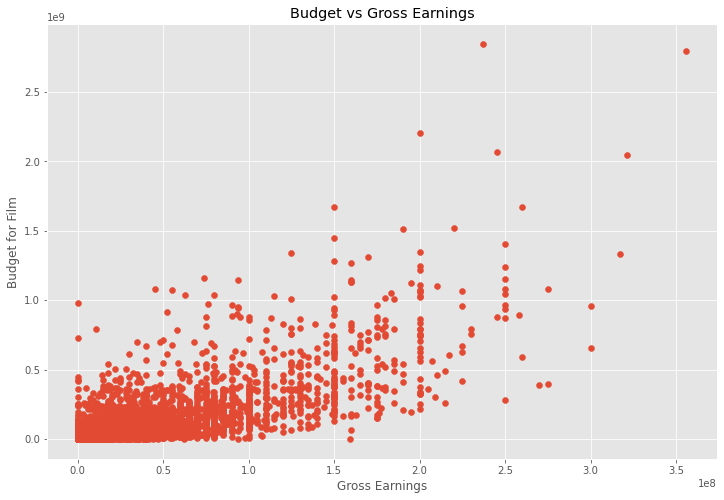

In [153]:
plt.scatter(x=df['budget'],y=df['gross'])
plt.xlabel('Gross Earnings')
plt.ylabel('Budget for Film')
plt.title('Budget vs Gross Earnings')

<AxesSubplot:xlabel='budget', ylabel='gross'>

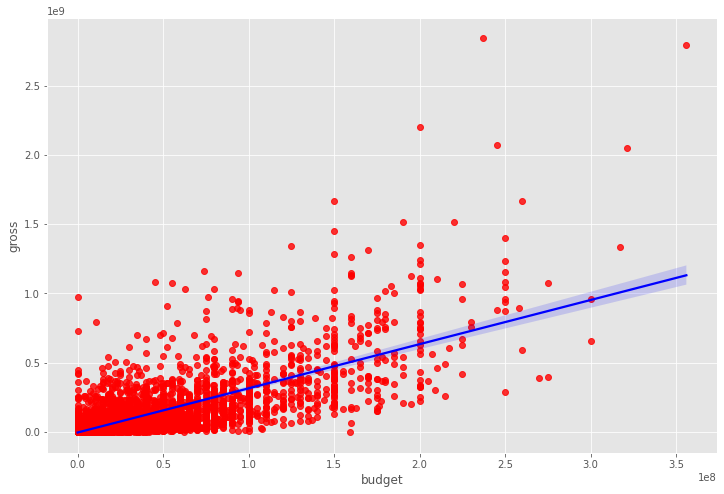

In [156]:
sns.regplot(x=df['budget'],y=df['gross'],data=df,scatter_kws ={'color':'red'},line_kws={'color':'blue'} )

In [158]:
# Find the Correlation
df.corr(method='pearson') #pearson #kendal #spearman

,score,votes,budget,gross,runtime
score,1.000000,0.391952,0.053473,0.177451,0.379436
votes,0.391952,1.000000,0.486931,0.632870,0.306984
budget,0.053473,0.486931,1.000000,0.750157,0.268372
gross,0.177451,0.632870,0.750157,1.000000,0.244339
runtime,0.379436,0.306984,0.268372,0.244339,1.000000


Text(0.5, 1.0, 'Correlation Matrix of Movie Features')

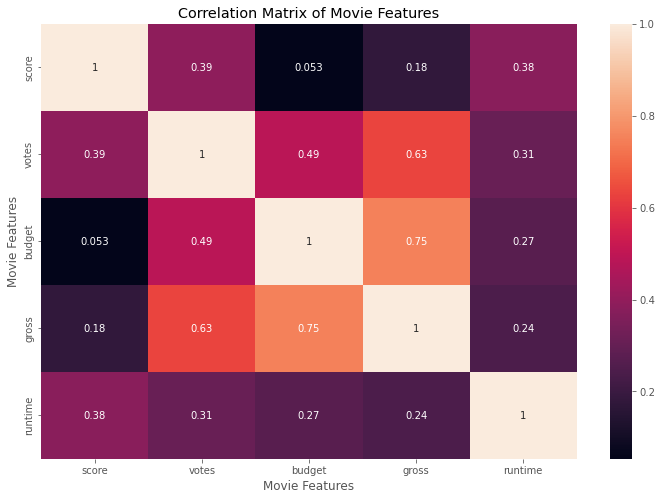

In [160]:
correlation_matrix=df.corr(method='pearson')

sns.heatmap(correlation_matrix, annot = True)
plt.xlabel('Movie Features')
plt.ylabel('Movie Features')
plt.title('Correlation Matrix of Movie Features')

In [162]:
# Try to use Numerical assignment for object type variable

df_numerized = df

for col in df_numerized.columns:
    if (df_numerized[col].dtype == 'object') :
        df_numerized[col] = df_numerized[col].astype('category')
        df_numerized[col] = df_numerized[col].cat.codes 

df_numerized.head()

,name,rating,genre,released,score,votes,director,writer,star,country,budget,gross,company,runtime,year
0,6587,6,6,1697,8,927000,2589,4014,1047,54,19000000,46998772,2319,146,47
1,5573,6,1,1484,5,65000,2269,1632,327,55,4500000,58853106,731,104,47
2,5142,4,0,1763,8,1200000,1111,2567,1745,55,18000000,538375067,1540,124,47
3,286,4,4,1484,7,221000,1301,2000,2246,55,3500000,83453539,1812,88,47
4,1027,6,4,1535,7,108000,1054,521,410,55,6000000,39846344,1777,98,47
5,2109,6,10,2492,6,123000,2528,4362,241,55,550000,39754601,1812,95,47
6,5574,6,0,1763,7,188000,1412,838,1277,55,27000000,115229890,2281,133,47
7,4436,6,3,697,8,330000,1829,1769,2240,55,18000000,23402427,631,129,47
8,5281,4,0,1745,6,101000,2306,1979,877,55,54000000,108185706,883,127,48
9,6213,6,3,2277,7,10000,2864,423,589,55,10000000,15795189,2272,100,47


Text(0.5, 1.0, 'Correlation Matrix of Movie Features')

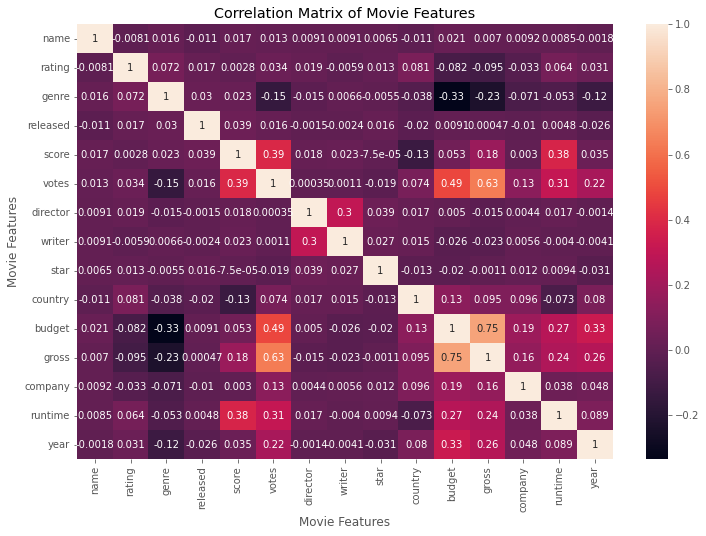

In [163]:
# Try to visualize the numerized dataframe
correlation_matrix=df_numerized.corr(method='pearson')

sns.heatmap(correlation_matrix, annot = True)
plt.xlabel('Movie Features')
plt.ylabel('Movie Features')
plt.title('Correlation Matrix of Movie Features')


In [164]:
# Try to find the numerical value between high correlations

correlation_matrix = df_numerized.corr(method='pearson')

corrmat_value = correlation_matrix.unstack()

corrmat_value.head()

name      name        1.000000
          rating     -0.008069
          genre       0.016355
          released   -0.011319
          score       0.017191
          votes       0.013038
          director    0.009079
          writer      0.009081
          star        0.006472
          country    -0.010737
          budget      0.020548
          gross       0.006989
          company     0.009211
          runtime     0.008483
          year       -0.001824
rating    name       -0.008069
          rating      1.000000
          genre       0.072423
          released    0.016643
          score       0.002753
          votes       0.033743
          director    0.019483
          writer     -0.005921
          star        0.013405
          country     0.081244
          budget     -0.081939
          gross      -0.095450
          company    -0.032943
          runtime     0.064133
          year        0.030909
genre     name        0.016355
          rating      0.072423
        

In [165]:
# Sort out the value
sorted_value = corrmat_value.sort_values()
sorted_value.head()

budget    genre      -0.334021
genre     budget     -0.334021
          gross      -0.234297
gross     genre      -0.234297
votes     genre      -0.145296
genre     votes      -0.145296
country   score      -0.125743
score     country    -0.125743
genre     year       -0.124469
year      genre      -0.124469
rating    gross      -0.095450
gross     rating     -0.095450
budget    rating     -0.081939
rating    budget     -0.081939
runtime   country    -0.073319
country   runtime    -0.073319
company   genre      -0.071067
genre     company    -0.071067
          runtime    -0.052914
runtime   genre      -0.052914
country   genre      -0.037615
genre     country    -0.037615
company   rating     -0.032943
rating    company    -0.032943
star      year       -0.030843
year      star       -0.030843
budget    writer     -0.025911
writer    budget     -0.025911
released  year       -0.025525
year      released   -0.025525
gross     writer     -0.022997
writer    gross      -0.022997
released

In [166]:
# Order the value
ordered_value = sorted_value[(sorted_value)>0.5]
ordered_value.head()

gross     votes       0.632870
votes     gross       0.632870
budget    gross       0.750157
gross     budget      0.750157
name      name        1.000000
writer    writer      1.000000
company   company     1.000000
gross     gross       1.000000
budget    budget      1.000000
country   country     1.000000
star      star        1.000000
director  director    1.000000
votes     votes       1.000000
score     score       1.000000
released  released    1.000000
genre     genre       1.000000
rating    rating      1.000000
runtime   runtime     1.000000
year      year        1.000000
dtype: float64

In [ ]:
# We finally obtain the high correlations
# Conclusion : Votes and Budgets has the 
# highest effect on Gross
